In [0]:
# !pip install fastai==0.7.0
# !pip install torch==0.4.1 torchvision==0.2.1
# !pip install imgaug

In [0]:
%matplotlib inline

In [0]:
from fastai.conv_learner import *
from fastai.dataset import *
# from fastai import *
  
from pathlib import Path
from PIL import ImageDraw,ImageFont
from matplotlib import patches,patheffects

In [0]:
# path = Path('gdrive/My Drive/Flipkart')

In [0]:
path = Path('')

In [0]:
# list(path.iterdir())

In [0]:
IMAGES = 'images'

In [0]:
df = pd.read_csv(path/'training.csv')

In [0]:
# df.head()

In [0]:
b_box = np.array(df.drop(columns='image_name')[['y1','x1','y2','x2']])

In [0]:
# b_box[0]

In [0]:
fnames = [path/IMAGES/i for i in df['image_name']]

In [0]:
# fnames[:5]

In [0]:
def bb_hw(b):
    return np.array([b[1],b[0],b[3]-b[1]+1,b[2]-b[0]+1])

In [0]:
def show_img(im , figsize=None,ax=None):
    if not ax: fig,ax=plt.subplots(figsize=figsize)
#     print(im.shape)
    ax.imshow(im)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    return ax

In [0]:
def draw_outline(o,lw):
    o.set_path_effects([patheffects.Stroke(linewidth=lw,foreground='black'),patheffects.Normal()])

In [0]:
def draw_rec(ax,b):
    patch = ax.add_patch(patches.Rectangle(b[:2],b[2],b[3],fill=False,edgecolor='red',lw=2))
    draw_outline(patch,4)

In [0]:
os.listdir(path/'images')[:1]

['1469784117103DSC_0718.png']

In [0]:
# str(fnames[10])

In [0]:
# indd = 16
# ax = show_img(plt.imread(str(fnames[indd])),figsize=(9,12))
# b = b_box[indd]
# print(b)
# b = bb_hw(b)
# print(b)
# draw_rec(ax,b)

In [0]:
!mkdir tmp

In [0]:
BB_CSV = path/'tmp/b_box_xf.csv'

In [0]:
BB_CSV

PosixPath('tmp/b_box_xf.csv')

In [0]:
bbs = [' '.join(str(p) for p in o) for o in b_box]
df2 = pd.DataFrame({'fn':df['image_name'],'bbox':bbs},columns=['fn','bbox'])
df2.to_csv(BB_CSV,index=False)

In [0]:
# BB_CSV.open().readlines()[:5]

In [0]:
f_model = resnet101
sz = 300
bs = 16

In [0]:
# augs = [RandomFlip(),
#        RandomRotate(30),
#        RandomLighting(0.1,0.1)]

In [0]:
# tfm_y = TfmType.COORD
# augs = [RandomFlip(tfm_y=tfm_y),
#         RandomDihedral(tfm_y=tfm_y),
#         RandomRotate(5, p=0.5, tfm_y=tfm_y),
#         RandomLighting(0.1,0.1, tfm_y=tfm_y)]

In [0]:
# tfms = tfms_from_model(f_model,sz,crop_type=CropType.NO,tfm_y=tfm_y,aug_tfms=augs)
# md = ImageClassifierData.from_csv(path,IMAGES,BB_CSV,tfms = tfms,continuous=True,bs=10)
# # md = ImageClassifierData.from_csv(path,IMAGES,BB_CSV,tfms=tfms,continuous=True,bs=10)

In [0]:
# ??

In [0]:
# ??ImageClassifierData

In [0]:
# x,y = next(iter(md.aug_dl))

In [0]:
# idx = 1
# fig ,axes = plt.subplots(3,3,figsize=(9,9))
# for i,ax in enumerate(axes.flat):
# #   x,y=next(iter(md.aug_dl))
#   x,y=next(iter(md.aug_dl))
#   ima = md.val_ds.denorm(to_np(x))[idx]
#   b = bb_hw(to_np(y[idx]))
#   print(b)
#   show_img(ima,ax=ax)
#   draw_rec(ax,b)

In [0]:
tfm_y = TfmType.COORD
augs = [RandomFlip(tfm_y=tfm_y),
        RandomDihedral(tfm_y=tfm_y),
        RandomRotate(10, p=0.2, tfm_y=tfm_y),
        RandomLighting(0.2,0.2, tfm_y=tfm_y)]

tfms = tfms_from_model(f_model, sz, crop_type=CropType.NO, tfm_y=tfm_y, aug_tfms=augs)
md = ImageClassifierData.from_csv(path, IMAGES, BB_CSV, tfms=tfms, bs=bs, continuous=True)

In [0]:
# def cust_loss(input,target):
# #   Y1 = F.mse_loss(input[:,0],target[:,0])
# #   X1 = F.mse_loss(input[:,1],target[:,1])
# #   Y2 = F.mse_loss(input[:,2],target[:,2])
# #   X2 = F.mse_loss(input[:,3],target[:,3])
#   target[:,4] = target[:,2]-target[:,0]
#   target[:,5] = target[:,3]-target[:,1]
#   target[:,6] = (target[:,0]+target[:,2])/2
#   target[:,7] = (target[:,1]+target[:,3])/2

  
#   return F.l1_loss(input,target)

In [0]:
head_reg4 = nn.Sequential(Flatten(),
                          nn.Linear(204800,4)
                         )
# head_reg4 = nn.Sequential(Flatten())

learn = ConvLearner.pretrained(f_model,md,custom_head=head_reg4,pretrained=False)
learn.opt_fn = optim.Adam
learn.crit = nn.MSELoss()
# learn.crit = iouLoss
# learn.matrics = [iouLossMat]

In [0]:
# learn.summary()

In [0]:
# learn.load('flipkart_50_extrafeature_1')

In [0]:
learn.freeze_to(0)

 76%|███████▌  | 529/700 [12:16<03:41,  1.29s/it, loss=5.37e+3]

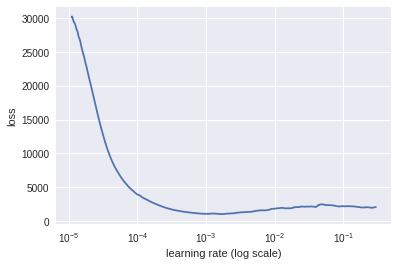

In [0]:
learn.lr_find(1e-5,10)
learn.sched.plot(5)

In [0]:
lr = 5e-5

In [0]:
learn.fit(lr,2,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      550.264731 483.332717
    1      415.141368 378.637227
    2      423.50856  333.350319


[333.35031866891046]

In [0]:
learn.save("upres101_4_1")
!rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
tmp.h5
upres101_4_1.h5

sent 347,681,053 bytes  received 57 bytes  77,262,468.89 bytes/sec
total size is 9,434,845,588  speedup is 27.14


In [0]:
lr = 1e-5
lrs = np.array([lr/100,lr/10,lr])

In [0]:
learn.load("upres101_4_1")

In [0]:
learn.unfreeze()

In [0]:
# learn.lr_find(1e-5,10)
# learn.sched.plot(5)

 33%|███▎      | 114/350 [04:26<08:19,  2.12s/it, loss=14.2]

In [0]:
learn.fit(lrs,2,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      390.342967 329.457952
    1      375.116729 323.504225
    2      366.073153 317.056349


[317.05634931291854]

In [0]:
learn.save("upres101_4_2")
!rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
upres101_4_2.h5

sent 173,841,398 bytes  received 38 bytes  69,536,574.40 bytes/sec
total size is 9,434,846,956  speedup is 54.27


In [0]:
learn.fit(lrs/10,2,cycle_len=2,cycle_mult=3)

epoch      trn_loss   val_loss   
    0      423.866321 316.84048 
    1      387.689949 316.756424
    2      388.726827 316.825942
    3      362.148909 315.037039
    4      412.409564 314.536093
    5      348.804464 314.748774
 34%|███▍      | 241/700 [05:37<17:52,  2.34s/it, loss=348]

In [0]:
lr = 1e-4
lrs = np.array([lr/1000,lr/10,lr])

In [0]:
learn.load('upres101_4_2')

In [0]:
learn.freeze_to(-10)

epoch      trn_loss   val_loss   
    0      32.387948  358899.84433


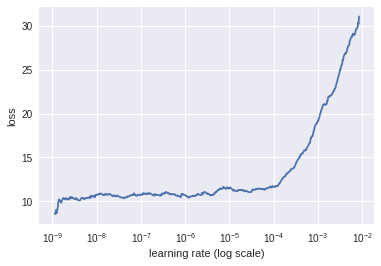

In [0]:
learn.lr_find(1e-9,1e-2)
learn.sched.plot(5)

In [0]:
learn.fit(lrs/10,1,cycle_len=2)

epoch      trn_loss   val_loss   
    0      10.891726  9.797228  
    1      10.747684  9.669036  


[9.66903594153268]

In [0]:
learn.save("upres101_4_3")
!rsync -auv "models/" "gdrive/My Drive/Flipkart/models/"

sending incremental file list
./
tmp.h5
upres101_4_3.h5

sent 347,681,339 bytes  received 57 bytes  63,214,799.27 bytes/sec
total size is 9,434,844,228  speedup is 27.14


In [0]:
learn.freeze_to(0)

In [0]:
learn.crit = nn.MSELoss()

In [0]:
learn.fit(lrs/100,1,cycle_len=1)

epoch      trn_loss   val_loss   
    0      352.775003 281.070881


[281.0708806392125]

In [0]:
!ls

sample_data


In [0]:
learn.save("pres101_4_3")

In [0]:
learn.load("pres101_4_2")

In [0]:
learn.freeze_to(-4)

In [0]:
lr = 1e-3
lrs = np.array([lr/100,lr/10,lr])

In [0]:
learn.fit(lrs,2,cycle_len=2)

epoch      trn_loss   val_loss   
    0      7.524852   6.175426  
    1      5.280796   4.409378  
 94%|█████████▍| 657/700 [16:06<01:03,  1.47s/it, loss=7.55]

In [0]:
learn.save('flipkart_50_extrafeature_p_1')

In [0]:
lr = 1e-3
lrs = np.array([lr/100,lr/10,lr])

In [0]:
learn.freeze_to(-12)

 82%|████████▏ | 288/350 [10:05<01:44,  1.68s/it, loss=52.7]

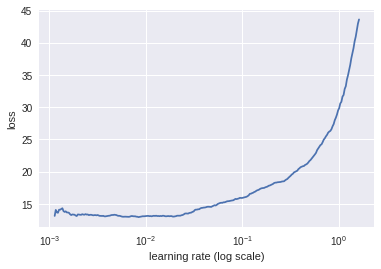

In [0]:
learn.lr_find(lrs)
learn.sched.plot(5)

In [0]:
learn.fit(lrs/10,2,cycle_len=3)

  5%|▌         | 18/350 [00:46<12:39,  2.29s/it, loss=12.7]

In [0]:
lrs = np.array([lr/100,lr/10,lr])

In [0]:
learn.freeze_to(-2)

 69%|██████▉   | 241/350 [06:55<07:35,  4.18s/it, loss=4.95e+3]

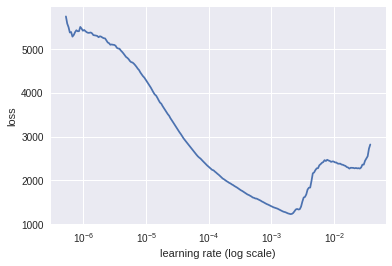

In [0]:
lrf=learn.lr_find(lrs/1000)
learn.sched.plot(1)


In [0]:
learn.fit(lrs,2,cycle_len=1,cycle_mult=2)

epoch      trn_loss   val_loss   
    0      308.809474 291.003885
    1      377.046392 371.198421
    2      275.080025 254.620527


[254.62052708217075]

In [0]:
learn.save('flipkart_50_l2_2')

In [0]:
lrs

array([0.00001, 0.0001 , 0.001  ])

In [0]:
learn.load('flipkart_34_1')

In [0]:
learn.fit(lrs, 2, cycle_len=1, cycle_mult=2)

epoch      trn_loss   val_loss   
    0      212.098886 168.72989 
    1      152.855712 128.853778
    2      95.406904  116.73716 


[116.73716018676758]

In [0]:
learn.save('flipkart_34_2')

In [0]:
learn.freeze_to(-3)

 63%|██████▎   | 110/175 [06:38<02:55,  2.70s/it, loss=17.7]

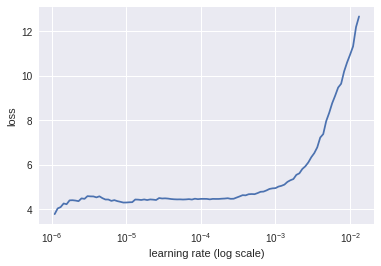

In [0]:
lrf=learn.lr_find(lrs/1000)
learn.sched.plot(1)


In [0]:
print(lrs)

[0.00001 0.0001  0.001  ]


In [0]:
learn.fit(lrs,2,cycle_len=3,)


epoch      trn_loss   val_loss   
    0      165.510819 139.26137 
    1      83.894591  104.775568
    2      58.027253  103.304603
    3      90.438501  119.722755
    4      56.376119  105.127294
    5      38.453516  95.894732 


[95.89473207746234]

In [0]:
learn.save('pres50_xf8_')

In [0]:
lrs

array([0.00001, 0.0001 , 0.001  ])

In [0]:
learn.

In [0]:
lrf=learn.lr_find(lrs)
learn.sched.plot(1)

 16%|█▌        | 56/350 [01:39<06:05,  1.24s/it, loss=99.6]

In [0]:
learn.load('flipkart_34_3')

In [0]:
learn.fit(lrs,2,cycle_len=3,)

epoch      trn_loss   val_loss   
    0      60.784483  113.940498
    1      48.599191  105.045783
    2      26.159966  97.83393  
    3      49.079396  102.939074
    4      28.530464  103.415561
    5      18.732969  102.814003


[102.81400266374861]

In [0]:

learn.unfreeze()

 69%|██████▉   | 121/175 [07:30<04:35,  5.11s/it, loss=15]  

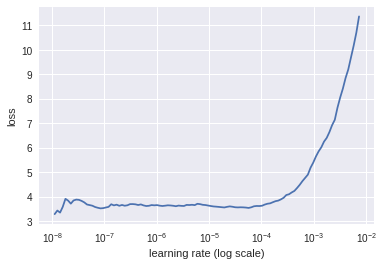

In [0]:
lrf=learn.lr_find(1e-8,10)
learn.sched.plot(1)

In [0]:
learn.load('flipkart')

In [0]:
x,y = next(iter(md.val_dl))
learn.model.eval()
preds = to_np(learn.model(VV(x)))

In [0]:
# preds

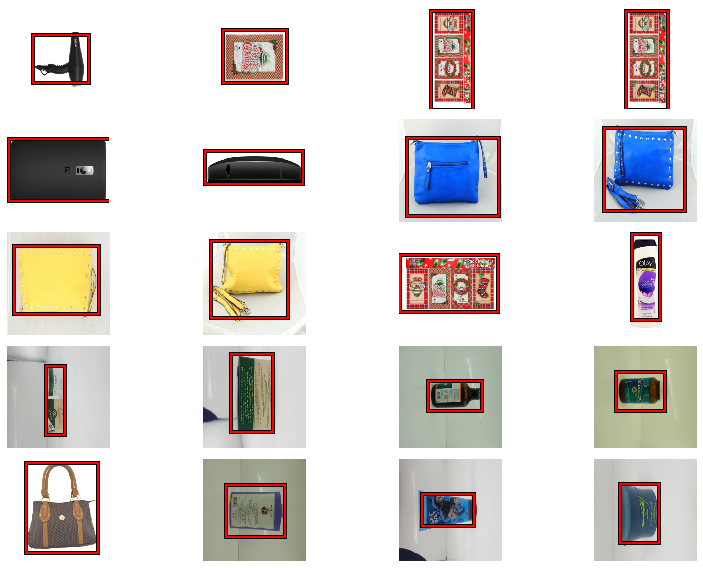

In [0]:
fig, axes = plt.subplots(5, 4, figsize=(12, 8))
for i,ax in enumerate(axes.flat):
    ima=md.val_ds.denorm(to_np(x))[i]
    b = bb_hw(preds[i])
    ax = show_img(ima, ax=ax)
    draw_rec(ax, b)
plt.tight_layout()

In [0]:
test_df = pd.read_csv('test.csv')

In [0]:
??ImageClassifierData

In [0]:
test_df.head()


,image_name,x1,x2,y1,y2
0,1474723840903DSC08089.png,NaN,NaN,NaN,NaN
1,1473231475010DeeplearnS11276.png,NaN,NaN,NaN,NaN
2,JPEG_20161205_135307_1000155917326.png,NaN,NaN,NaN,NaN
3,JPEG_20160711_123440_1000518778437.png,NaN,NaN,NaN,NaN
4,JPEG_20160803_115329_100034020722.png,NaN,NaN,NaN,NaN


In [0]:
TEST = path/'tmp/test.csv'

In [0]:
t_df = pd.DataFrame({'fn':test_df['image_name']})

In [0]:
t_df.to_csv(TEST,index=False)


In [0]:
TEST.open().readlines()[:5]

['fn\n',
 '1474723840903DSC08089.png\n',
 '1473231475010DeeplearnS11276.png\n',
 'JPEG_20161205_135307_1000155917326.png\n',
 'JPEG_20160711_123440_1000518778437.png\n']

In [0]:
test = 'gdrive/My Drive/Flipkart/test_image'

In [0]:
tfm_y = TfmType.COORD
augs = [RandomFlip(tfm_y=tfm_y),
        RandomRotate(3, p=0.5, tfm_y=tfm_y),
        RandomLighting(0.05,0.05, tfm_y=tfm_y)]

tfms = tfms_from_model(f_model, sz, crop_type=CropType.NO, tfm_y=tfm_y, aug_tfms=augs)
md2 = ImageClassifierData.from_csv(path, IMAGES, BB_CSV, tfms=tfms,test_name = test, bs=bs, continuous=True)

In [0]:
len(md2.test_ds.fnames)

12815

In [0]:
head_reg4 = nn.Sequential(Flatten(),nn.Linear(51200,4))
learn = ConvLearner.pretrained(f_model,md2,custom_head=head_reg4)
learn.opt_fn = optim.Adam
learn.crit = nn.L1Loss()

Downloading: "https://download.pytorch.org/models/resnet34-333f7ec4.pth" to /root/.torch/models/resnet34-333f7ec4.pth
100%|██████████| 87306240/87306240 [00:01<00:00, 47456953.63it/s]


In [0]:
learn.load('flipkart')

In [0]:
!ls

gdrive	images	models	sample_data  test.csv  test_image  tmp	training.csv


In [0]:
import numpy as np

In [0]:
yp = np.zeros((12815,4),dtype='float')

In [0]:
# md2.test_ds.y = yp

In [0]:
x,y = next(iter(md2.test_dl))
# learn.model.eval()

In [0]:
x.shape

torch.Size([64, 3, 300, 300])

In [0]:
preds = to_np(learn.model(VV(x)))

In [0]:
# md2.test_ds.denorm(to_np(x[0])

(1, 300, 300, 3)

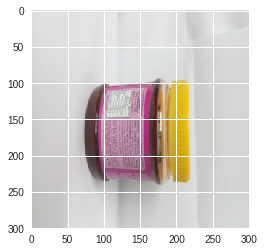

In [0]:
# plt.imshow(md2.test_ds.denorm(to_np(x[40]))[0])

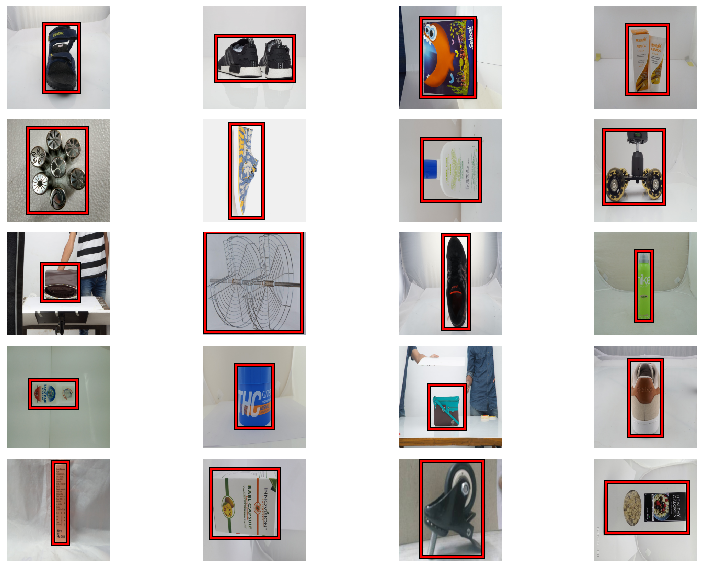

In [0]:
fig, axes = plt.subplots(5, 4, figsize=(12, 8))
for i,ax in enumerate(axes.flat):
    ima=md2.test_ds.denorm(to_np(x))[i]
    b = bb_hw(preds[i])
    ax = show_img(ima, ax=ax)
    draw_rec(ax, b)
plt.tight_layout()

In [0]:
y_pred = learn.predict(is_test=True)

In [0]:
pred_df = pd.DataFrame(data = y_pred,columns = ['y1','x1','y2','x2'])

In [0]:
pred_df.to_csv('gdrive/My Drive/Flipkart/prediction.csv',index = False)

In [0]:
pred_df = pd.read_csv('gdrive/My Drive/Flipkart/prediction.csv')

In [0]:
pred_df2 = pred_df.copy()

In [0]:
pred_df.head()

,y1,x1,y2,x2
0,52.903873,111.95331,249.77792,206.59332
1,89.802050,37.60590,215.68631,266.41592
2,34.106210,66.47142,264.68054,221.95717
3,55.621883,97.13947,255.56026,213.35158
4,23.881296,61.03829,272.46027,230.53653


In [0]:
pred_df2['y1'] = pred_df['y1']/300*480
pred_df2['x1'] = pred_df['x1']/300*640
pred_df2['y2'] = pred_df['y2']/300*480
pred_df2['x2'] = pred_df['x2']/300*640

In [0]:
pred_df2.head()

,y1,x1,y2,x2
0,84.646197,238.833728,399.644672,440.732416
1,143.683280,80.225920,345.098096,568.353963
2,54.569936,141.805696,423.488864,473.508629
3,88.995013,207.230869,408.896416,455.150037
4,38.210074,130.215019,435.936432,491.811264


In [0]:
test_df_names = pd.DataFrame({'image_name':md2.test_ds.fnames})

In [0]:
test_df_names['image_name'] = [str(i).replace('gdrive/My Drive/Flipkart/test_image/','') for i in test_df_names['image_name']]

In [0]:
test_df_names.head()

,image_name
0,1474723840903DSC08089.png
1,1473231475010DeeplearnS11276.png
2,JPEG_20161205_135307_1000155917326.png
3,JPEG_20160711_123440_1000518778437.png
4,JPEG_20160803_115329_100034020722.png


In [0]:
test_df_names[['y1','x1','y2','x2']] = pred_df2[['y1','x1','y2','x2']]

In [0]:
md2.test_ds.fnames[:10]

['gdrive/My Drive/Flipkart/test_image/1474723840903DSC08089.png',
 'gdrive/My Drive/Flipkart/test_image/1473231475010DeeplearnS11276.png',
 'gdrive/My Drive/Flipkart/test_image/JPEG_20161205_135307_1000155917326.png',
 'gdrive/My Drive/Flipkart/test_image/JPEG_20160711_123440_1000518778437.png',
 'gdrive/My Drive/Flipkart/test_image/JPEG_20160803_115329_100034020722.png',
 'gdrive/My Drive/Flipkart/test_image/147444974116511473239803010-Mast--Harbour-Men-Blue-Printed-Regular-Boat-Shoes-3651473239802717-2.png',
 'gdrive/My Drive/Flipkart/test_image/JPEG_20160622_110649_1000527459853.png',
 'gdrive/My Drive/Flipkart/test_image/JPEG_20160823_120737_1000784898268.png',
 'gdrive/My Drive/Flipkart/test_image/1480965956645IMG_3094.png',
 'gdrive/My Drive/Flipkart/test_image/14732348976417a565e40d545452688130062b267a2d2.png']

In [0]:
pred_df2.head()

,y1,x1,y2,x2
0,84.646197,238.833728,399.644672,440.732416
1,143.683280,80.225920,345.098096,568.353963
2,54.569936,141.805696,423.488864,473.508629
3,88.995013,207.230869,408.896416,455.150037
4,38.210074,130.215019,435.936432,491.811264


In [0]:
test_df_names.head()

,image_name,y1,x1,y2,x2
0,1474723840903DSC08089.png,84.646197,238.833728,399.644672,440.732416
1,1473231475010DeeplearnS11276.png,143.683280,80.225920,345.098096,568.353963
2,JPEG_20161205_135307_1000155917326.png,54.569936,141.805696,423.488864,473.508629
3,JPEG_20160711_123440_1000518778437.png,88.995013,207.230869,408.896416,455.150037
4,JPEG_20160803_115329_100034020722.png,38.210074,130.215019,435.936432,491.811264


In [0]:
submission = test_df_names[['image_name','x1','x2','y1','y2']]

In [0]:
submission.head()

,image_name,x1,x2,y1,y2
0,1474723840903DSC08089.png,238.833728,440.732416,84.646197,399.644672
1,1473231475010DeeplearnS11276.png,80.225920,568.353963,143.683280,345.098096
2,JPEG_20161205_135307_1000155917326.png,141.805696,473.508629,54.569936,423.488864
3,JPEG_20160711_123440_1000518778437.png,207.230869,455.150037,88.995013,408.896416
4,JPEG_20160803_115329_100034020722.png,130.215019,491.811264,38.210074,435.936432


In [0]:
submission.to_csv('submission.csv',index = False)

In [0]:
test_df.head()

,image_name,x1,x2,y1,y2
0,1474723840903DSC08089.png,NaN,NaN,NaN,NaN
1,1473231475010DeeplearnS11276.png,NaN,NaN,NaN,NaN
2,JPEG_20161205_135307_1000155917326.png,NaN,NaN,NaN,NaN
3,JPEG_20160711_123440_1000518778437.png,NaN,NaN,NaN,NaN
4,JPEG_20160803_115329_100034020722.png,NaN,NaN,NaN,NaN


In [0]:
y_pred = np.array(test_df_names[['y1','x1','y2','x2']])

In [0]:
y_pred

array([[ 84.6462 , 238.83373, 399.64467, 440.73242],
       [143.68328,  80.22592, 345.0981 , 568.35396],
       [ 54.56994, 141.8057 , 423.48886, 473.50863],
       ...,
       [ -1.19118,  21.58325, 463.00533, 477.11119],
       [144.78494, 229.91168, 350.80899, 528.35164],
       [100.77159,  18.49324, 371.88459, 617.99778]])

In [0]:
!ls

[ 28.17147 258.02701 452.82064 393.73171]
[258.02701  28.17147 136.7047  425.64917]


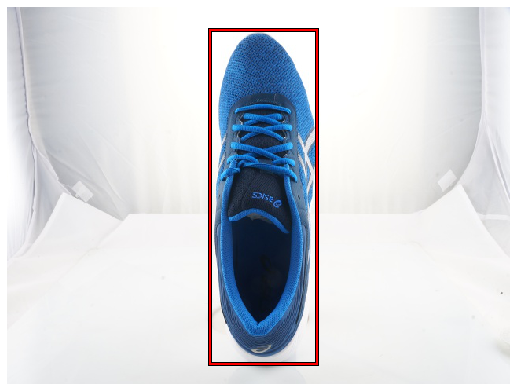

In [0]:
indd = 100

# ax = show_img(plt.imread(str(md2.test_ds.fnames[indd])),figsize=(9,12))
im2 = plt.imread(str(md2.test_ds.fnames[indd]))
# im2 = cv2.resize(im2,(300,300))
ax = show_img(im2,figsize=(9,12))
b = y_pred[indd]
print(b)
b = bb_hw(b)
print(b)
draw_rec(ax,b)

In [0]:
tmd = ImageClassifierData.test_ds.

In [0]:
??ImageClassifierData

In [0]:
list(md.aug_dl)

In [0]:
!mkdir 'gdrive/My Drive/Flipkart/test_image'

In [0]:
import cv2

In [0]:
for i in tqdm(test_df['image_name'][:1]):
  p = path/IMAGES/i
#   print(str(p))
#   im = cv2.imread(str(p))
  npp = path/'gdrive/My Drive/Flipkart/test_image'/i
#   cv2.imwrite(str(np),im)
  
  

100%|██████████| 1/1 [00:00<00:00, 869.65it/s]
